In [1]:
#importing all necessary libraries and packages

import pandas as pd
import geopandas as gpd
import plotly.express as px
import matplotlib.pyplot as plt
from matplotlib import gridspec as gridspec
import statsmodels.api as sm
from plotly.subplots import make_subplots
import plotly.graph_objects as go


In [11]:
#reading in files

#durham county shapefile
durham_county = gpd.read_file("/Users/morganbernstein/Desktop/DATA+/Small-Town-Policing-Accountability-Data-2022/DurhamBlockMap/DurhamBlockMap.shp")

#beats shapefile
beats = gpd.read_file("/Users/morganbernstein/Desktop/DATA+/Small-Town-Policing-Accountability-Data-2022/filtered_beats/filtered_beats.shp")

#geometry of beats with percent [race] by beat
demo = gpd.read_file("/Users/morganbernstein/Desktop/DATA+/Small-Town-Policing-Accountability-Data-2022/30 Spatial Mapping/demo_beat_data/demographic_summary_arrests_per_beat.shp")
demo.set_index("Beat", inplace = True)

#full dataframe of arrests with beat number and geometry
arrests = pd.read_csv("/Users/morganbernstein/Desktop/DATA+/Small-Town-Policing-Accountability-Data-2022/10 Clean Data/with_beats.csv", index_col = [0])

#35 rows, one for each beat, with percents of [race] by beat
by_beat = pd.read_csv('/Users/morganbernstein/Desktop/DATA+/Small-Town-Policing-Accountability-Data-2022/10 Clean Data/GROUPEDBY_BEAT.csv', index_col = [0])

/var/folders/kc/zg1krfm17h74s97_rljtrhpr0000gn/T/ipykernel_92290/3800259872.py:14: DtypeWarning:

Columns (51,57,62,63,65,66,67,68,71,73,152,153,155,156,157,158,159,161,162,163,164,165,167,168,169,170,171,173,174,175,176,177,179,180,181,182,183,185,186,187,188,189,191,192,193,194,195,197,198,199,200,201,203,204,205,206,207,209,210,211,212,213,215,216,217,218,219,221,222,223,224,225,227,228,229) have mixed types. Specify dtype option on import or set low_memory=False.



Text(162.62408012871626, 0.5, 'Latitude')

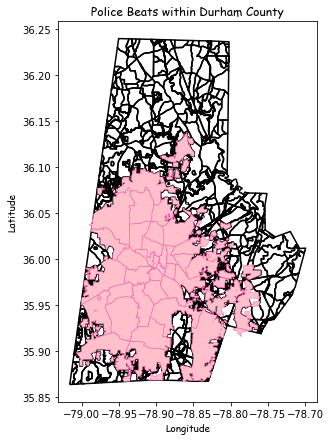

In [12]:
#OVERLAP TWO SHAPEFILES INTO ONE
#plotting the durham police beats within durham county

plt.rcParams["figure.figsize"] = (9,7)

ax = durham_county.plot(color='none', edgecolor='black', linewidths=1.5)
beats.plot(ax=ax, color='pink', edgecolor='hotpink', linewidths=0.5)


plt.title("Police Beats within Durham County", family = "Comic Sans MS")
plt.xlabel('Longitude', family = "Comic Sans MS")
plt.ylabel('Latitude', family = "Comic Sans MS")

In [5]:
#used this before, already in the file now


"""
#making new column to show the percent of white only residents in each beat
demo["percent_white"] = demo["white_only"] / demo["Total_"]

#making new column to show the percent of poc residents in each beat
demo["percent_poc"] = demo["poc"] / demo["Total_"]

#making new column to show the percent of any part black residents in each beat
demo["percent_apb"] = demo["any_part_b"] / demo["Total_"]
demo.head()

#converting it to a file 
demo.to_file("/Users/morganbernstein/Downloads/demo_beat_data/demographic_summary_arrests_per_beat.shp")"""

'#making new column to show the percent of white only residents in each beat\ndemo["percent_white"] = demo["white_only"] / demo["Total_"]\n\n#making new column to show the percent of poc residents in each beat\ndemo["percent_poc"] = demo["poc"] / demo["Total_"]\n\n#making new column to show the percent of any part black residents in each beat\ndemo["percent_apb"] = demo["any_part_b"] / demo["Total_"]\ndemo.head()\n\ndemo.to_file("/Users/morganbernstein/Downloads/demo_beat_data/demographic_summary_arrests_per_beat.shp")'

In [13]:
#making interactive map to show beat number and percent of people who are white only

fig = px.choropleth(demo,
                   title="Percent of Population that is White Only by Police Beat",
                   geojson=demo.geometry,
                   locations=demo.index,
                   color="percent_wh",
                   projection="mercator",
                   color_continuous_scale="ylgnbu",
                   range_color=(0,1),
                   labels = {"percent_wh" : "Percent White Only Residents", "index" : "Beat"}
                   )

fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(title_font=dict(color = "pink"), legend_font=dict(color = "pink"))
fig.show()

In [14]:
#same map for poc residents

fig = px.choropleth(demo,
                   title="Percent of Population that is POC by Police Beat",
                   geojson=demo.geometry,
                   locations=demo.index,
                   color="percent_po",
                   projection="mercator",
                   range_color=[0,1],
                   color_continuous_scale="ylgnbu",
                   labels = {"percent_po" : "Percent POC Residents", "index" : "Beat"}
                   )
fig.update_geos(fitbounds="locations", visible=False)
fig.show()

In [15]:
#same map for any part black residents

fig = px.choropleth(demo,
                   title="Percent of Population that is Any Part Black by Police Beat",
                   geojson=demo.geometry,
                   locations=demo.index,
                   color="percent_ap",
                   projection="mercator",
                   color_continuous_scale="Blues",
                   range_color=[0,1],
                   hover_data=["percent_ap"],
                   labels = {"percent_ap" : "Percent Any Part Black Residents", "LAWBEAT" : "Beat"}
                   )
fig.update_geos(fitbounds="locations", visible=False)
fig.show()



In [16]:
#map fo white only residents plotted within the streets of durham

fig = px.choropleth_mapbox(demo,
                           geojson=demo.geometry,
                           locations=demo.index,
                           #color="white_only",
                           center={"lat": 36.0222, "lon": -78.9031},
                           mapbox_style="open-street-map",
                           zoom=8.5)
fig.show()

In [17]:
#reading in file of demographic data and geometry data
demo = gpd.read_file("/Users/morganbernstein/Desktop/DATA+/Small-Town-Policing-Accountability-Data-2022/30 Spatial Mapping/demo_beat_data/demographic_summary_arrests_per_beat.shp")


#merging dataset with the total arrests by beat
full = pd.merge(demo, by_beat[["LAWBEAT", "Black", "White", "Asian", "Unknown", "Indigenous", "total"]], left_on = "Beat", right_on = "LAWBEAT")
full.set_index("Beat", inplace = True)


In [18]:
#making new columns to represent the percent of residents and percent of arrests per beat

full["percent_white"] = round(full["white_only"] / full["Total_"], 5)
full["percent_poc"] = round(full["poc"] / full["Total_"], 5)
full["percent_apb"] = round(full["any_part_b"] / full["Total_"], 5)

full["percent_white_A"] = round(full["White"] / full["total"], 5)
full["percent_black_A"] = round(full["Black"] / full["total"], 5)
full["percent_poc_A"] = round(1 - full["percent_white_A"], 5)

#making a log ratio column to show the percent of arrests / percent of residents
# per race for each of the police beats
full["log_B"] = full["percent_black_A"] / full["percent_apb"]
full["log_W"] = round(full["percent_white_A"] / full["percent_white"], 5)
full["log_POC"] = round(full["percent_poc_A"] / full["percent_poc"], 5)

#looking at dataset
full.head()

,any_part_b,poc,white_only,Total_,poc+white,percent_wh,percent_po,percent_ap,geometry,LAWBEAT,...,total,percent_white,percent_poc,percent_apb,percent_white_A,percent_black_A,percent_poc_A,log_B,log_W,log_POC
Beat,,,,,,,,,,,,,,,,,,,,,
111,110368.0,175921.0,132972.0,306304.0,308893.0,0.434118,0.574335,0.360322,"POLYGON ((-78.89039 36.01517, -78.89038 36.015...",111,...,506,0.43412,0.57433,0.36032,0.12648,0.86364,0.87352,2.396869,0.29135,1.52094
112,80783.0,127532.0,84580.0,210497.0,212112.0,0.401811,0.605861,0.383773,"POLYGON ((-78.88787 36.01473, -78.88734 36.014...",112,...,692,0.40181,0.60586,0.38377,0.18497,0.81214,0.81503,2.116215,0.46034,1.34524
113,92042.0,148412.0,110685.0,256153.0,259097.0,0.432105,0.579388,0.359324,"POLYGON ((-78.87372 35.99369, -78.87458 35.991...",113,...,654,0.43211,0.57939,0.35932,0.16208,0.82416,0.83792,2.293666,0.37509,1.44621
114,97282.0,152684.0,112517.0,263492.0,265201.0,0.427022,0.579464,0.369203,"POLYGON ((-78.86954 35.99292, -78.86941 35.992...",114,...,569,0.42702,0.57946,0.36920,0.15817,0.84007,0.84183,2.275379,0.37040,1.45278
114,97282.0,152684.0,112517.0,263492.0,265201.0,0.427022,0.579464,0.369203,"POLYGON ((-78.84601 35.96433, -78.84515 35.964...",114,...,569,0.42702,0.57946,0.36920,0.15817,0.84007,0.84183,2.275379,0.37040,1.45278


In [19]:
#choropleth map to show percent white arrests per police beat

fig = px.choropleth(full,
                   title="Percent of White Arrests by Police Beat",
                   geojson=full.geometry,
                   locations=full.index,
                   color="percent_white_A",
                   projection="mercator",
                   color_continuous_scale="ylgnbu",
                   range_color=[0,1],
                   hover_data=["percent_white_A", "percent_white"],
                   labels = {"percent_white_A" : "Percent White Arrests",
                             "percent_white" : "Percent White Residents"}                   )
fig.update_geos(fitbounds="locations", visible=False)
fig.show()

In [20]:
# same map, percent black arrests per police beat

fig = px.choropleth(full,
                   title="Percent of Black Arrests by Police Beat",
                   geojson=full.geometry,
                   locations=full.index,
                   color="percent_black_A",
                   projection="mercator",
                   color_continuous_scale="ylgnbu",
                   range_color=[0,1],
                   hover_data=["percent_black_A", "percent_apb"],
                   labels = {"percent_black_A" : "Percent Black Arrests",
                             "percent_apb" : "Percent Any Part Black Residents"}
                   )
fig.update_geos(fitbounds="locations", visible=False)
fig.show()

In [21]:
# map to show percent poc arrests per police beat

fig = px.choropleth(full,
                   title="Percent of POC Arrests by Police Beat",
                   geojson=full.geometry,
                   locations=full.index,
                   color="percent_poc_A",
                   projection="mercator",
                   color_continuous_scale="ylgnbu",
                   range_color=[0,1],
                   hover_data=["percent_poc_A", "percent_poc"],
                   labels = {"percent_poc_A" : "Percent POC Arrests",
                             "percent_poc" : "Percent POC Residents"}
                   )
fig.update_geos(fitbounds="locations", visible=False)
fig.show()

(0.0, 1.0)

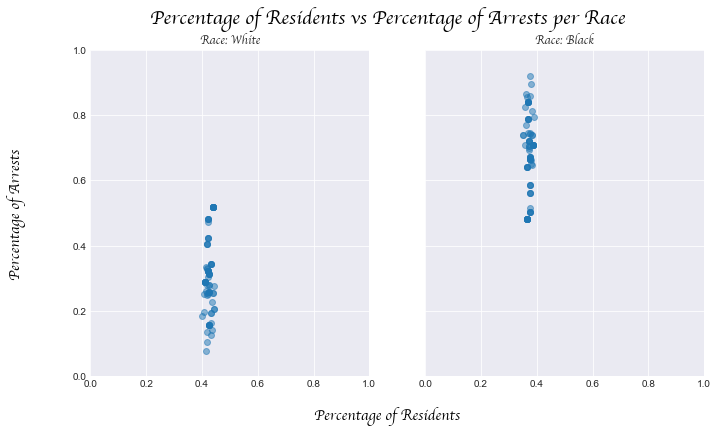

In [22]:
#two scatterplots showing percent of residents and percent of arrests for both white and black

#create a space to put the plots, specify size of the space, set the space equal to a variable (fig)
fig = plt.figure(figsize = (11,6))
fig.suptitle('Percentage of Residents vs Percentage of Arrests per Race', size = 20, family = "cursive")
fig.supxlabel("Percentage of Residents", size = 15, family = "cursive")
fig.supylabel("Percentage of Arrests", size = 15, family = "cursive")

plt.style.use('seaborn-darkgrid')

#defining hwo the subplots will be placed in the figure, 1 corresponds to number of rows, 2 is number of columns, width ratios is how big the subplots will be
gs = gridspec.GridSpec(1, 2, width_ratios = [1, 1])

ax1 = fig.add_subplot(gs[0])
ax2 = fig.add_subplot(gs[1], sharey=ax1)
plt.setp(ax2.get_yticklabels(), visible=False)
#ax3 = fig.add_subplot(gs[2])


ax1.plot(full["percent_white"], full["percent_white_A"], "o", alpha = .5)
#ax1.set_xlabel("Percent White Residents")
#ax1.set_ylabel("Percent White Arrests")
ax1.set_title("Race: White", size = 12, family = "cursive")
#ax1.set_xlim(.25, .5)
ax1.set_xlim(0, 1)
ax1.set_ylim(0, 1)

ax2.plot(full["percent_apb"], full["percent_black_A"], "o", alpha = .5)
#ax2.set_xlabel("Percent Any Part Black Residents")
#ax2.set_ylabel("Percent Black Arrests")
ax2.set_title("Race: Black", size = 12, family = "cursive")
#ax2.set_xlim(.25, .5)
ax2.set_xlim(0, 1)
ax2.set_ylim(0, 1)



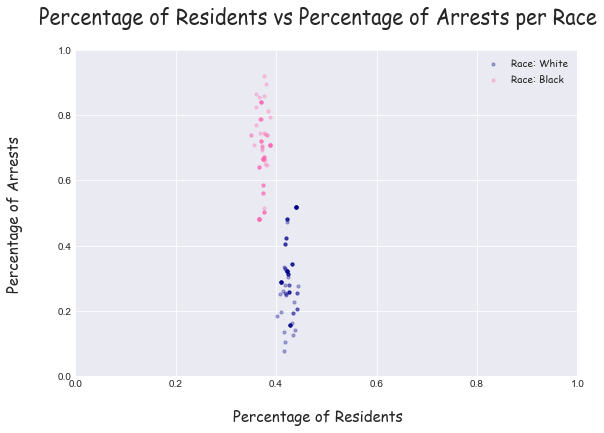

In [23]:
#same as before in a single figure
# shows the percentage of residents vs percentage of arrests 

#for white and black for each police beat
fig = plt.figure(figsize = (9,6))
ax1 = fig.add_subplot()

fig.suptitle('Percentage of Residents vs Percentage of Arrests per Race', size = 20, family = "Comic Sans MS")
fig.supxlabel("Percentage of Residents", size = 15, family = "Comic Sans MS")
fig.supylabel("Percentage of Arrests", size = 15, family = "Comic Sans MS")

ax1.set_xlim(.3, .5)
ax1.set_xlim(0, 1)
ax1.set_ylim(0, 1)

ax1.scatter(full["percent_white"], full["percent_white_A"], s=10, c='darkblue', alpha = .3, label='Race: White')
ax1.scatter(full["percent_apb"], full["percent_black_A"], s=10, c='hotpink', alpha = .3, label='Race: Black')
plt.legend(loc='upper right', prop={'family': 'Comic Sans MS'})
plt.show()

In [24]:
#making bar charts of the log ratio percent residents to percent arrests per police beat
# race: white

full1 = full.copy()
full1["LAWBEAT"] = full1["LAWBEAT"].astype(str)
full1 = full1.drop_duplicates(subset = "LAWBEAT")

fig = px.bar(full1, x='LAWBEAT', y='log_W',
title = "Log Ratio of % White Residents to % White Arrests per Beat <br><sup>Log Ratio = % White Residents / % White Arrests</sup>",
                    #color = "log_W",
                    hover_data=['LAWBEAT'],
                    template = "plotly_white",
                    labels = {"LAWBEAT" : "Beat Number",
                            "log_W" : "% W Residents / % W Arrests",
                             "percent_white_A" : "Percent White Arrests",
                             "percent_white" : "Percent White Residents"})

fig.update_layout(yaxis_range=[0,2.5])
fig.show()

In [22]:
#bar chart of log ratio for black residents and arrests

fig = px.bar(full1, x='LAWBEAT', y='log_B',
title = "Log Ratio of % Black Residents to % Black Arrests per Beat <br><sup>Log Ratio = % Black Residents / % Black Arrests</sup>",
                    #color = "log_W",
                    hover_data=['LAWBEAT'],
                    template = "plotly_white",
                    labels = {"LAWBEAT" : "Beat Number",
                            "log_B" : "% B Residents / % B Arrests",
                             "percent_black_A" : "Percent Black Arrests",
                             "percent_black" : "Percent Black Residents"})

fig.update_layout(yaxis_range=[0,2.5])
fig.show()

In [23]:
#bar chart of log ratio for poc residents and arrests


#making a bar graph of the log ratio of % POC residents to % POC arrests per police beat
fig = px.bar(full1, x='LAWBEAT', y='log_POC',
title = "Log Ratio of % POC Residents to % POC Arrests per Beat <br><sup>Log Ratio = % POC Residents / % POC Arrests</sup>",
                    #color = "log_POC",
                    hover_data=['LAWBEAT'],
                    template = "plotly_white",
                    labels = {"LAWBEAT" : "Beat Number",
                            "log_POC" : "% POC Residents / % POC Arrests",
                             "percent_poc_A" : "Percent POC Arrests",
                             "percent_poc" : "Percent POC Residents"})

fig.update_layout(yaxis_range=[0,2.5])
fig.show()

In [24]:
# Just playing around with graphs and how to represent the data
# 
# making a stacked bar plot of percent residents for poc and white per police beat and
#percent arrests for poc and white per police beat
fig = make_subplots(rows=2, cols=1,
                    shared_xaxes=True)
                    
fig.add_trace(
    go.Bar(
        name="% White Residents",
        x=full1["LAWBEAT"],
        y=full1["percent_white"],
        offsetgroup=0, marker_color = '#024a70'
    ),
    row=1,
    col=1,
)
fig.add_trace(
    go.Bar(
        name="% POC Residents",
        x=full1["LAWBEAT"],
        y=full1["percent_poc"],
        offsetgroup=0,
        base=full1["percent_white"], marker_color = '#74d0f0'
    ),
    row=1,
    col=1,

)

fig.add_trace(
    go.Bar(
        name="% White Arrests",
        x=full1["LAWBEAT"],
        y=full1["percent_white_A"],
        offsetgroup=0, marker_color = '#051c2c'
    ),
    row=2,
    col=1,
)
fig.add_trace(
    go.Bar(
        name="% POC Arrests",
        x=full1["LAWBEAT"],
        y=full1["percent_poc_A"],
        offsetgroup=0,
        base=full1["percent_white_A"], marker_color = '#abe5f0'
    ),
    row=2,
    col=1,

)
fig.update_layout(title="% White vs POC Residents and Arrests per Beat", title_font_family = "Droid Serif")
fig.update_xaxes(title="Beat Number")

fig.show()

In [25]:
# More random visulizations
# 
# making a graph with subplots of the percentage of residents and percentage of arrests per police beat
fig = make_subplots(rows=3, cols=1,
                    shared_xaxes=True)

fig.add_trace(
    go.Bar(
        name="% White Residents",
        x=full1["LAWBEAT"],
        y=full1["percent_white"],
    ),
    row=1,
    col=1,
)
fig.add_trace(
    go.Bar(
        name="% White Arrests",
        x=full1["LAWBEAT"],
        y=full1["percent_white_A"],
    ),
    row=1,
    col=1,
)

fig.add_trace(
    go.Bar(
        name="% Black Residents",
        x=full1["LAWBEAT"],
        y=full1["percent_apb"],
    ),
    row=2,
    col=1,
)
fig.add_trace(
    go.Bar(
        name="% Black Arrests",
        x=full1["LAWBEAT"],
        y=full1["percent_black_A"],
    ),
    row=2,
    col=1,
)

fig.add_trace(
    go.Bar(
        name="% POC Residents",
        x=full1["LAWBEAT"],
        y=full1["percent_poc"],
    ),
    row=3,
    col=1,
)
fig.add_trace(
    go.Bar(
        name="% POC Arrests",
        x=full1["LAWBEAT"],
        y=full1["percent_poc_A"],
    ),
    row=3,
    col=1,
)

fig.show()

In [26]:
#map to show log ratio of white only residents to arrests

fig = px.choropleth(full,
                   title = "Log Ratio of % White Residents to % White Arrests per Beat <br><sup>Log Ratio = % White Residents / % White Arrests</sup>",
                   geojson=full.geometry,
                   locations=full.LAWBEAT,
                   color="log_W",
                   projection="mercator",
                   color_continuous_scale="ylgnbu",
                   range_color=(0,2.5),
                   labels = {"log_W" : "Log Ratio Residents to Arrests", "index" : "Beat"}
                   )

fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(title_font=dict(color = "pink"), legend_font=dict(color = "pink"))
fig.show()

'#making interactive map to show log ratio of white only\n\nfig = px.choropleth(full,\n                   title = "Log Ratio of % White Residents to % White Arrests per Beat <br><sup>Log Ratio = % White Residents / % White Arrests</sup>",\n                   geojson=full.geometry,\n                   locations=full.LAWBEAT,\n                   color="log_W",\n                   projection="mercator",\n                   color_continuous_scale="ylgnbu",\n                   range_color=(0,2.5),\n                   labels = {"log_W" : "Log Ratio Residents to Arrests", "index" : "Beat"}\n                   )\n\nfig.update_geos(fitbounds="locations", visible=False)\nfig.update_layout(title_font=dict(color = "pink"), legend_font=dict(color = "pink"))\nfig.show()'

In [27]:
#map to show log ratio of black only residents to arrests

fig = px.choropleth(full,
                   title = "Log Ratio of % Black Residents to % Black Arrests per Beat <br><sup>Log Ratio = % Black Residents / % Black Arrests</sup>",
                   geojson=full.geometry,
                   locations=full.LAWBEAT,
                   color="log_B",
                   projection="mercator",
                   color_continuous_scale="ylgnbu",
                   range_color=(0,2.5),
                   labels = {"log_B" : "Log Ratio Residents to Arrests", "index" : "Beat"}
                   )

fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(title_font=dict(color = "pink"), legend_font=dict(color = "pink"))
fig.show()

'#making interactive map to show log ratio of black only\n\nfig = px.choropleth(full,\n                   title = "Log Ratio of % Black Residents to % Black Arrests per Beat <br><sup>Log Ratio = % Black Residents / % Black Arrests</sup>",\n                   geojson=full.geometry,\n                   locations=full.LAWBEAT,\n                   color="log_B",\n                   projection="mercator",\n                   color_continuous_scale="ylgnbu",\n                   range_color=(0,2.5),\n                   labels = {"log_B" : "Log Ratio Residents to Arrests", "index" : "Beat"}\n                   )\n\nfig.update_geos(fitbounds="locations", visible=False)\nfig.update_layout(title_font=dict(color = "pink"), legend_font=dict(color = "pink"))\nfig.show()'

In [25]:
# map to show log ratio of poc residents to arrests

fig = px.choropleth(full,
                   title = "Log Ratio of % POC Residents to % POC Arrests per Beat <br><sup>Log Ratio = % POC Residents / % POC Arrests</sup>",
                   geojson=full.geometry,
                   locations=full.LAWBEAT,
                   color="log_POC",
                   projection="mercator",
                   color_continuous_scale="ylgnbu",
                   range_color=(0,2.5),
                   labels = {"log_POC" : "   ", "index" : "Beat"}
                   )

fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(title_font=dict(color = "pink"), legend_font=dict(color = "pink"))
fig.show()

#log ratio preserves ordering but changing the scale to see differences more clearly